<div style="width: 100%; text-align: center;">

<h1 style="color:rgb(244, 244, 245); font-size: 40px; font-weight: bold;">
    <span style="text-decoration-color: white;">THE LAST OF US: 
    <span style="color:rgb(130, 89, 214);">DEEP LEARNING EDITION</span></span> 🎮
</h1>

<hr style="height: 10px; width: 100%; background-color: white; border: none; margin-top: 10px; margin-bottom: 10px;">
</div>



<img src="/kaggle/input/content/TLOU2.jpg" alt="The Last of Us" style="width: 100%; max-height: 500px; object-fit: cover;">


---

<p style="font-size: 18px;"> In the world of <b>The Last of Us</b>, society has collapsed due to the <b>Cordyceps Brain Infection (CBI)</b>, a fungal outbreak that transforms humans into aggressive, zombie-like creatures known as the <b>Infected</b>. Amidst this chaos, survivors navigate a perilous existence, facing threats from both the Infected and other human factions. </p> <p style="font-size: 18px;"> Our protagonist, <b>Ellie</b>, has endured unimaginable loss and hardship. After tragedy strikes her closest companions, she embarks on a relentless quest for justice. Her journey takes her across the desolate landscapes of a post-apocalyptic America, where she must confront both the horrors of the Infected and the ruthless factions vying for power. </p> <p style="font-size: 18px;"> Ellie's pursuit leads her to the ruins of <b>Hollywood</b>, a city once synonymous with glamour and fame, now a haunting wasteland overrun by the Infected. Intelligence suggests that members of the <b>Washington Liberation Front (WLF)</b> have infiltrated this area, disguising themselves among the hordes to evade detection. To achieve her goal, Ellie must distinguish friend from foe amidst the chaos. </p> <p style="font-size: 18px;"> In this dire scenario, Ellie turns to advanced technology for assistance. She discovers that, much like the Infected emit a distinct scent, humans possess unique facial features that can be analyzed to identify individuals. To leverage this, Ellie employs a <b>Variational Autoencoder (VAE)</b>, a deep learning model capable of learning and disentangling the underlying factors of facial images. By training the VAE on a dataset of celebrity faces, Ellie aims to develop a tool that can differentiate between the Infected, innocent survivors, and hidden WLF operatives. </p> <p style="font-size: 18px;"> This mission is not just about vengeance; it’s about survival, resilience, and the pursuit of justice in a world where morality is no longer black and white. With the VAE as her ally, Ellie embarks on a path fraught with danger, hope, and the unyielding human spirit's fight for redemption. </p>


<div style="width: 100%; text-align: center;">
<h1 style="color:rgb(244, 244, 245); font-size: 40px; font-weight: bold;">
    <span style="text-decoration-color: white;">Let's Start the: 
    <span style="color:rgb(130, 89, 214);">Hunt</span></span> 🐾
</h1>
<hr style="height: 10px; width: 100%; background-color: white; border: none; margin-top: 10px; margin-bottom: 10px;">
</div>


# Here is Some Music to help you settle in for the Journey Ahead !

In [1]:
from IPython.display import Audio

# Replace 'your_audio_file.mp3' with your actual file name
audio_file = "/kaggle/input/content/03. The Last of Us.mp3"

# Display an audio player in the notebook
Audio(audio_file)


---

# <u>**Understanding Variational Autoencoders (VAEs)**</u>

## 📌 What is a Variational Autoencoder?
A **Variational Autoencoder (VAE)** is a **generative model** that learns to encode input data into a **latent space representation** and then reconstruct it back. Unlike traditional **Autoencoders**, VAEs introduce **probabilistic sampling** in the latent space, making them effective for generating new data and disentangling representations.

### 🔹 **Key Idea**
Instead of mapping an input $x$ to a fixed latent vector $z$, VAEs model the latent space as a **distribution**:

- **Encoder**: Learns a **mean** $\mu$ and **variance** $\sigma^2$ for each latent dimension.
- **Latent Space**: Instead of a fixed vector, we **sample** $z$ from a Gaussian distribution:
  
  $$
  z = \mu + \sigma \cdot \epsilon, \quad \epsilon \sim \mathcal{N}(0,1)
  $$

- **Decoder**: Takes the sampled $z$ and reconstructs the input image $\hat{x}$.

This allows for **smooth interpolations** and **better disentangled features** in the latent space.

---

## 📌 What is the **β-Hyperparameter**? 🛠️
The **β-VAE** (Beta Variational Autoencoder) introduces a **hyperparameter** $\beta$ in the loss function to **control the trade-off** between:

- **Reconstruction Quality** (How well the image is reconstructed).
- **Disentanglement** (How independent the latent factors are).

The modified **VAE loss function** becomes:

$$
\mathcal{L} = \mathbb{E}_{q(z|x)} [\log p(x|z)] - \beta D_{KL}(q(z|x) || p(z))
$$

Where:
- $\mathbb{E}_{q(z|x)} [\log p(x|z)]$ = **Reconstruction Loss** (Measures how well the output matches the input).
- $D_{KL}(q(z|x) || p(z))$ = **KL Divergence** (Forces latent space to follow a standard Gaussian distribution).
- $\beta$ = A scaling factor that controls the balance between reconstruction and disentanglement.

---

## 📌 **Why is KL Divergence Important?**
**Kullback-Leibler (KL) Divergence** measures how much one probability distribution **differs** from another. In VAEs, we use it to **regularize the latent space**, ensuring it follows a normal distribution.

### **🔹 General Formula for KL Divergence**
For any two probability distributions \( P(x) \) and \( Q(x) \), the KL Divergence is defined as:

$$
D_{KL}(P \parallel Q) = \sum_{x \in \mathcal{X}} P(x) \log \frac{P(x)}{Q(x)}
$$

This equation measures how much **information is lost** when \( Q(x) \) is used to approximate \( P(x) \). In simpler terms, it **penalizes deviations** from the target distribution.

### **🔹 KL Divergence in VAEs**
In **VAEs**, our encoder learns a latent representation \( q(z|x) \), which we want to keep **close to** a standard Gaussian prior \( p(z) \). Since both distributions are assumed to be **Gaussian**, we can derive a closed-form solution for KL Divergence:

$$
D_{KL}(q(z|x) \parallel p(z)) = \frac{1}{2} \sum_{i=1}^{d} \left( 1 + \log(\sigma_i^2) - \mu_i^2 - \sigma_i^2 \right)
$$

### **What do these terms represent?**
- **$\mu_i$**: The mean of the latent variable $z_i$.
- **$\sigma_i^2$**: The variance of the latent variable $z_i$.
- **$d$**: The dimensionality of the latent space.
- **$D_{KL}(q(z|x) || p(z))$**: Measures how much the learned latent space deviates from the assumed standard normal distribution.

### **Why do we need KL regularization?**
✅ It prevents **overfitting**.  
✅ It ensures **smooth latent representations**.  
✅ It allows for **better interpolation and sampling**.  

---


<!-- INSPIRATION PAPER HEADER -->
<div style="text-align: center;">
    <h2 style="color:rgb(248, 248, 244); font-size: 40px; font-weight: bold;">
        📜 <b>Inspiration for This Assignment</b>  
    </h2>
</div>

<!-- INSPIRATION PAPER BLOCK -->
<div style="padding: 25px; text-align: center; font-size: 22px; font-weight: bold; color:rgb(242, 244, 245);
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; width: 70%; margin: auto;
            box-shadow: 0px 0px 30px rgba(213, 223, 16, 0.99);">
    
For this assignment, we will be taking **inspiration** from the following paper:  
📖 **[[Disentangled Representation Learning](https://arxiv.org/abs/2211.11695)]**  

Feel free to **read this for insights** and use it as a guide.  

</div>

<hr style="height: 10px; width: 80%; background: linear-gradient(to right, white, #FFD700, white); border: none; margin-top: 15px; margin-bottom: 15px;">

<!-- CHAPTER 1 HEADER -->
<div style="text-align: center;">
    <h1 style="color: #FF8C00; font-size: 55px; font-weight: bold;">
        🍁 <span style="color: white;">Chapter 1</span> -  
        <span style="color: #FFD700;">Fall</span> 🍂
        <span style="color: white;">[30 Points]</span>
    </h1>
    <hr style="height: 10px; width: 80%; background: linear-gradient(to right, white, #FF8C00, white); border: none; margin-top: 10px; margin-bottom: 10px;">
</div>

<!-- INTRODUCTION -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white;
            background: rgba(0, 0, 0, 0.6); border-radius: 15px;
            width: 80%; margin: auto;
            box-shadow: 0px 0px 30px rgba(255, 140, 0, 0.6);">
    
<b>The journey begins, not with a model, but with data.</b>  
This time, **you won’t be given a pre-processed dataset**—  
Instead, **you must take control.**  

In this part of the assignment, your task is to **load the raw CelebA dataset and preprocess it yourself.**  
This is an **essential skill** for anyone in this field:  

✅ **Identify, clean, and prepare data**  
✅ **Decide on preprocessing techniques**  
✅ **Gain full creative freedom** based on task requirements  

Your **dataset, your rules.**  
Your **pipeline, your approach.**  
**Let's begin.**  

</div>

<!-- WHAT IS CELEBA? -->
<div style="padding: 10px; text-align: center;">
    <h2 style="color: #FFD700; font-size: 35px; font-weight: bold;">
        🏷️ <b>What is the CelebA Dataset?</b>
    </h2>
</div>

<div style="padding: 30px; text-align: justify; font-size: 22px; color: white;
            background: rgba(0, 0, 0, 0.6); border-radius: 15px;
            width: 80%; margin: auto;
            box-shadow: 0px 0px 30px rgba(255, 140, 0, 0.6);">

CelebA (**Large-scale CelebFaces Attributes Dataset**) is one of the **most widely used datasets** in **computer vision & deep learning research**.  
It contains **202,599 images of celebrities** with **40 attribute labels** per image.  

💡 **Why is CelebA Important?**  
- It enables **facial attribute prediction** (e.g., age, gender, hair color, eyeglasses, etc.).  
- It allows experimentation with **variational autoencoders (VAEs)** for **feature disentanglement**.  
- It is **diverse**, containing **faces of different expressions, poses, and occlusions**.  

💾 **Dataset Structure:**  
📂 **img_align_celeba/** → The actual images (cropped & aligned)  
📄 **list_attr_celeba.txt** → Binary labels (1 or -1) for each image  
📄 **list_eval_partition.txt** → Specifies train/test/val splits  

**For this task, you will decide which files are needed based on your preprocessing choices.**  

</div>

<!-- TASK OVERVIEW HEADER -->
<div style="text-align: center;">
    <h2 style="color: #FFD700; font-size: 35px; font-weight: bold;">
        🎯 <b>Task Overview: Loading & Preprocessing CelebA</b>
    </h2>
</div>

<!-- TASK DETAILS -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white;
            background: rgba(0, 0, 0, 0.6); border-radius: 15px;
            width: 80%; margin: auto;
            box-shadow: 0px 0px 30px rgba(255, 140, 0, 0.6);">

📌 **Download the dataset** from this Link: ([CelebA Official Repository](https://mmlab.ie.cuhk.edu.hk/projects/CelebA.html)).  
💡 **Recommendation:** Use the **Aligned & Cropped Zip Folder**, but the choice is **yours**.  
📖 **Read the ReadMe File available in the dataset directory** to understand **what’s available**.  

### **🛠️ What You Need to Do:**
🔍 **Step 1:** Identify **which files** are necessary for your task. (Hint: You will need the Attributes, The Partitions and The Images themselves)
📥 **Step 2:** Download the required files from the link.  
📂 **Step 3:** Load the dataset into your notebook **(You are free to use ChatGPT, a custom loader, or any other method—Full Creative Freedom).**  
🖼️ **Step 4:** Display **5 random samples** from the **train** split & **5 random samples** from the **test** split.  
📑 **Step 5:** **Examples of what your visualizations should look like are in the FAQs document.**  

⚠️ **IMPORTANT:** The CelebA dataset is **too large** to be used in its entirety.  
🚀 **We strongly recommend reducing it to a subset of 50,000 images** (80-20 split for Train/Eval).  
- **This will significantly reduce training time.**  
- **With 50,000 images, training will take ~40 minutes (CPU) on all β-values.**  
- **Ignoring this will slow down your progress!**  

</div>

<!-- FINAL GRADING WARNING -->
<div style="padding: 30px; text-align: center; font-size: 22px; font-weight: bold; color: red;
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; width: 80%; margin: auto;
            box-shadow: 0px 0px 30px rgba(255, 0, 0, 0.6);">

⚠️ **Your marks for this task depend entirely on your success in loading and visualizing the dataset.**  
If done incorrectly, you **might not be able to complete the rest of the tasks.**  

</div>


In [2]:
import os
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import random
from sklearn.model_selection import train_test_split
import torch
import shutil
import numpy as np
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from PIL import Image
from tqdm import tqdm
from collections import defaultdict

In [3]:
image_dir = '/kaggle/input/dataset/img_align_celeba/img_align_celeba'
attr_file = '/kaggle/input/dataset/list_attr_celeba.txt'
all_images = sorted(os.listdir(image_dir))[:50000]

train_imgs, val_imgs = train_test_split(all_images, test_size=0.2, random_state=42)


attributes = pd.read_csv(attr_file, sep='\s+', header=1)
attributes.index.name = 'image_id'
attributes.reset_index(inplace=True)
subset_attr = attributes[attributes['image_id'].isin(all_images)]

print(f"train size: {len(train_imgs)}")
print(f"val size: {len(val_imgs)}")


train size: 40000
val size: 10000


In [4]:
batch_size = 128
class CelebADataset(Dataset):
    def __init__(self, image_list, image_dir, attr_df=None, transform=None):
        self.image_list = image_list
        self.image_dir = image_dir
        self.attr_df = attr_df
        self.transform = transform

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        img_name = self.image_list[idx]
        img_path = os.path.join(self.image_dir, img_name)
        image = Image.open(img_path)

        if self.transform:
            image = self.transform(image)

        return image, 0


transform = transforms.Compose([
    transforms.Resize((128, 128)),

    transforms.ToTensor()
])

train_dataset = CelebADataset(train_imgs, image_dir, attributes, transform)
val_dataset = CelebADataset(val_imgs, image_dir, attributes, transform)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=2)


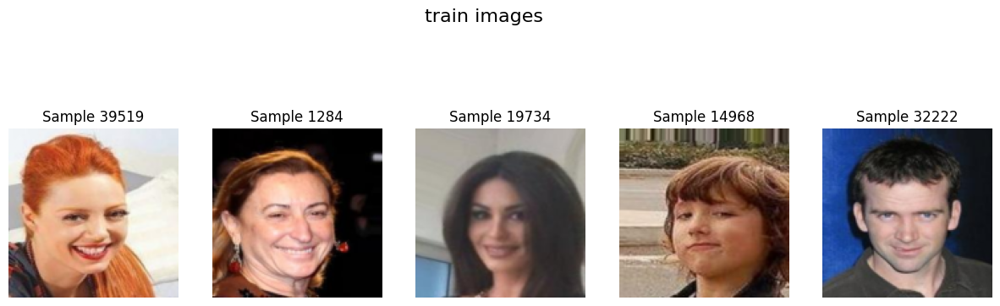

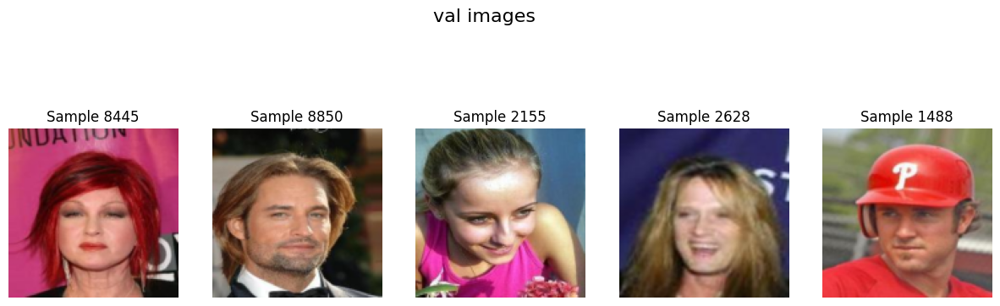

In [5]:
def print_images(dataset, title, num_images=5):
    indices = random.sample(range(len(dataset)), num_images)

    plt.figure(figsize=(15, 5))
    for i, idx in enumerate(indices):
        image, _ = dataset[idx]
        image = image.permute(1, 2, 0)

        plt.subplot(1, num_images, i + 1)
        plt.imshow(image)
        plt.title(f"Sample {idx}")
        plt.axis('off')

    plt.suptitle(title, fontsize=16)
    plt.show()

print_images(train_dataset, "train images")
print_images(val_dataset, "val images")


<div style="text-align: center;">
    <h1 style="color: rgb(255, 183, 76); font-size: 50px; font-weight: bold;">
        ☀️ <span style="color: white;">Chapter 2</span> -  
        <span style="color: rgb(255, 183, 76);">Summer</span> ☀️
        <span style="color: white;">[30 Points]</span>
    </h1>
    <hr style="height: 8px; width: 80%; background: linear-gradient(to right, white, rgb(255, 183, 76), white); border: none; margin-top: 10px; margin-bottom: 10px;">
</div>


<!-- MISSION HEADER -->
<div style="text-align: center;">
    <h1 style="color: #FFA500; font-size: 55px; font-weight: bold;">
        💻 <span style="color: white;">TIME TO START CODING!</span> 💻
    </h1>
</div>

<!-- CINEMATIC INTRO -->
<div style="padding: 25px; text-align: center; font-size: 24px; font-style: italic; color: white;
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; width: 70%; margin: auto;
            box-shadow: 0px 0px 30px rgba(255, 165, 0, 0.6);">
    
"This is where the real challenge begins..."  
Ellie’s journey led her here. **Your journey begins now.**

</div>

<hr style="height: 8px; width: 80%; background: linear-gradient(to right, white, #FFA500, white); border: none; margin-top: 15px; margin-bottom: 15px;">

<!-- MISSION OBJECTIVE TITLE -->
<div style="text-align: center;">
    <h2 style="color: rgb(255, 183, 76); font-size: 35px; font-weight: bold;">
        🎯 <b>Mission Objective:</b> Train a <b>β-VAE</b> to Disentangle Features and Uncover the WLF Operatives
    </h2>
</div>

<!-- STORY-THEMED CODING CHALLENGE -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white;
            background: rgba(0, 0, 0, 0.6); border-radius: 15px;
            width: 80%; margin: auto;
            box-shadow: 0px 0px 30px rgba(255, 165, 0, 0.6);">

The **data is ready**, the **tools are set**, and now it’s time to **dive into the unknown**.  
Just like **Ellie**, you must **navigate through uncertainty**,  
experiment with different **β-values**, and **uncover the hidden representations** within faces.

</div>

<!-- FINAL CALL TO ACTION -->
<div style="padding: 20px; text-align: center; font-size: 22px; font-weight: bold; color: rgb(255, 183, 76);">
    You are on your own from this point onwards.  
    <br> <b>Good luck, survivor.</b> 🏹🔥
</div>


## **🔹 Your Task: Complete the β-VAE Implementation**

### **📌 Key Components to Consider**
1. **Encoder (`encode` function)**
   - Takes an input image .
   - Passes it thorugh **Convolution Layers**
   - Outputs two vectors:
     - **Mean (μ):** The predicted mean of the latent distribution.
     - **Log variance (logσ²):** The predicted variance (log-scale) of the latent distribution.

1. **Reparameterization Trick (`reparameterize` function)**
   - Uses the **mean (μ) and log variance (logσ²)** to create a latent vector **z**.
   - Adds **random noise** to make the model **stochastic**.

2. **Decoder (`decode` function)**
   - Takes a latent vector **z**.
   - Passes it through **transposed convolution layers** to reconstruct the image.

3. **Forward Pass (`forward` function)**
   - Takes an input image.
   - **Encodes → Reparameterizes → Decodes** it.
   - Returns **the reconstructed image, mean, and log variance**.

`Note:`: You do not neccseccarily need to follow the structure above , you are free to make whatever functions you require , change constructors values, Adjust Hyperparameters, GO CRAZY (Clicker Symptoms Starting to show xD).Please also look into how different 'latent_dim' values effect your results and why? Currently a default value of 10 is set



# B-VAE Architecture

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class BetaVAE(nn.Module):
    def __init__(self, latent_dim=10, beta=1.0):
        """
        Beta-VAE Model
        
        Args:
            latent_dim (int): Dimension of the latent space (default = 10)
            beta (float): Weighting factor for KL divergence in loss function
        """
        super(BetaVAE, self).__init__()
        self.beta = beta  # Hyperparameter for disentanglement
        self.latent_dim = latent_dim
        # 🚀 Define the encoder, decoder, and other layers here

        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, 4, stride=2, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.Conv2d(32, 64, 4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, 512, 4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(),
        )
        self.flatten = nn.Flatten()
        self.fc_mu = nn.Linear(512 * 4 * 4, latent_dim)
        self.fc_logvar = nn.Linear(512 * 4 * 4, latent_dim)

        # Decoder
        self.decoder_input = nn.Linear(latent_dim, 512 * 4 * 4)
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, 4, stride=2, padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 3, 4, stride=2, padding=1),
            nn.Sigmoid()
        )


    def encode(self, x):
        """
        Encode input image to latent space representations (μ, logσ²).
        """
        x = self.encoder(x)
        x = self.flatten(x)
        mu = self.fc_mu(x)
        logvar = self.fc_logvar(x)
        return mu, logvar

    def reparameterize(self, mu, logvar):
        """
        Reparameterization trick to sample latent vector z from μ and logσ².
        """
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        """
        Decode latent vector z back to image space.
        """
        x = self.decoder_input(z)
        x = x.view(-1,512,4,4)
        x = self.decoder(x)
        return x

    def forward(self, x):
        """
        Full forward pass: Encode → Reparameterize → Decode
        """
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        recon_x = self.decode(z)
        return recon_x, mu, logvar

# B-VAE Loss

In [7]:
def beta_vae_loss(recon_x, x, mu, logvar, beta=1.0):
    """
    Beta-VAE Loss Function
    
    Args:
        recon_x: Reconstructed image
        x: Original image
        mu: Mean of latent distribution
        logvar: Log variance of latent distribution
        beta: KL divergence weighting factor

    Returns:
        Total loss
    """
    # 🚀 Reconstruction Loss (can also try BCE for binary-scaled images)
    recon_loss = F.mse_loss(recon_x, x, reduction='sum')

    # 🚀 KL Divergence: encourages latent distribution to be close to N(0,1)
    kld_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    # 🚀 Total Loss: weighted combination
    total_loss = recon_loss + beta * kld_loss

    return recon_loss, kld_loss, total_loss


# 📌 Training Instructions
Now that you have implemented the Beta-VAE, it's time to train it on the CelebA dataset.
### 🎯 Your Tasks
- ✅ Train the Beta-VAE with at least 4 different β values (1, 5, 10, 50).
- ✅ Train for a minimum of 3 epochs (you can train for more).
- ✅ Log and analyze how different β values affect:
- Pleas use `tqdm` library to track progress as it can take up to `45 mins of training` on a CPU

In [8]:
# Training 
# 🚀 1. Define Hyperparameters
latent_dim = [10,15,20,25]
batch_size = 128
num_epochs = 3
learning_rate = 1e-3
beta = 5
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 🚀 3. Define Training Function
def train_epoch(model, dataloader, optimizer, beta):
    model.train()
    total_recon = 0.0
    total_kld = 0.0
    total_loss = 0.0

    for x, _ in tqdm(dataloader, desc="Training", leave=False):
        x = x.to(device)
        optimizer.zero_grad()
        recon_x, mu, logvar = model(x)
        recon_loss, kld_loss, loss = beta_vae_loss(recon_x, x, mu, logvar, beta)
        loss.backward()
        optimizer.step()

        total_recon += recon_loss.item()
        total_kld += kld_loss.item()
        total_loss += loss.item()

    N = len(dataloader.dataset)
    return total_recon / N, total_kld / N, total_loss / N

# 🚀 4. Define Validation Function
def validate_epoch(model, dataloader, beta):
    model.eval()
    total_recon = 0.0
    total_kld = 0.0
    total_loss = 0.0

    with torch.no_grad():
        for x, _ in tqdm(dataloader, desc="Validating", leave=False):
            x = x.to(device)
            recon_x, mu, logvar = model(x)
            recon_loss, kld_loss, loss = beta_vae_loss(recon_x, x, mu, logvar, beta)

            total_recon += recon_loss.item()
            total_kld += kld_loss.item()
            total_loss += loss.item()

    N = len(dataloader.dataset)
    return total_recon / N, total_kld / N, total_loss / N

# 🚀 2. Initialize Model & Optimizer
# 🚀 5. Train Model for Each β Value
results = defaultdict(list)

for dim in latent_dim:
    print(f"\ntraining in latent = {dim}")
    model = BetaVAE(latent_dim=dim, beta=beta).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

    for epoch in range(num_epochs):
        print(f"epoch {epoch+1}/{num_epochs}")
        tr_recon, tr_kld, tr_total = train_epoch(model, train_loader, optimizer, beta)
        val_recon, val_kld, val_total = validate_epoch(model, val_loader, beta)

        print(f"Train Recon: {tr_recon:.2f} KLD: {tr_kld:.2f} Total: {tr_total:.2f}")
        print(f"Val Recon: {val_recon:.2f} KLD: {val_kld:.2f} Total: {val_total:.2f}")

        results[dim].append({
            "train_recon": tr_recon,
            "train_kld": tr_kld,
            "train_total": tr_total,
            "val_recon": val_recon,
            "val_kld": val_kld,
            "val_total": val_total,
        })

    # Save model
    save_path = f"/kaggle/working/beta_vae_latent{dim}.pt"
    torch.save(model.state_dict(), save_path)
    print(f"Model saved to: {save_path}")




training in latent = 10
epoch 1/3


Train Recon: 1829.41 KLD: 28.40 Total: 1971.40
Val Recon: 1403.81 KLD: 25.07 Total: 1529.15
epoch 2/3


Train Recon: 1307.31 KLD: 24.40 Total: 1429.31
Val Recon: 1313.91 KLD: 24.21 Total: 1434.98
epoch 3/3


Train Recon: 1256.67 KLD: 23.51 Total: 1374.21
Val Recon: 1221.93 KLD: 23.10 Total: 1337.41
Model saved to: /kaggle/working/beta_vae_latent10.pt

training in latent = 15
epoch 1/3


Train Recon: 1657.01 KLD: 32.76 Total: 1820.83
Val Recon: 1184.29 KLD: 31.49 Total: 1341.74
epoch 2/3


Train Recon: 1100.16 KLD: 30.69 Total: 1253.61
Val Recon: 1040.75 KLD: 31.74 Total: 1199.44
epoch 3/3


Train Recon: 1054.07 KLD: 30.37 Total: 1205.94
Val Recon: 1059.94 KLD: 29.78 Total: 1208.86
Model saved to: /kaggle/working/beta_vae_latent15.pt

training in latent = 20
epoch 1/3


Train Recon: 1745.60 KLD: 36.60 Total: 1928.60
Val Recon: 1041.37 KLD: 37.86 Total: 1230.64
epoch 2/3


Train Recon: 1025.94 KLD: 36.45 Total: 1208.21
Val Recon: 950.44 KLD: 35.64 Total: 1128.62
epoch 3/3


Train Recon: 958.83 KLD: 36.16 Total: 1139.65
Val Recon: 957.27 KLD: 34.25 Total: 1128.53
Model saved to: /kaggle/working/beta_vae_latent20.pt

training in latent = 25
epoch 1/3


Train Recon: 1716.83 KLD: 36.96 Total: 1901.63
Val Recon: 1105.13 KLD: 44.33 Total: 1326.76
epoch 2/3


Train Recon: 967.76 KLD: 39.87 Total: 1167.12
Val Recon: 922.44 KLD: 41.26 Total: 1128.74
epoch 3/3


Train Recon: 904.64 KLD: 40.70 Total: 1108.15
Val Recon: 842.67 KLD: 41.80 Total: 1051.66
Model saved to: /kaggle/working/beta_vae_latent25.pt


## 📊 **Logging Your Results**

Once you have trained your **β-VAE** model with different β values, log your results in a table format like the one below.

|   **Beta Value** |   **Total Loss** |   **KL Divergence** |   **Reconstruction Loss** |
|:--------------:|:-------------:|:----------------:|:----------------------:|
| 1  | 1189.31 | 32.7504 | 1156.56 |
| 5  | 1261.73 | 22.6921 | 1148.27 |
| 10 | 1330.06 | 18.7226 | 1142.84 |
| 50 | 1837.18 | 10.5795 | 1308.21 |

### 📌 **How to Interpret Your Table**
- **Total Loss**: The overall loss for the VAE combining both **reconstruction loss** and **KL divergence**.
- **KL Divergence**: How much the learned latent space deviates from a normal Gaussian distribution.
- **Reconstruction Loss**: Measures how well the model reconstructs the input images.

📢 **Your task is to analyze how the KL Divergence and Reconstruction Loss change as β increases!**


In [9]:
# Create a table of final validation losses
table_data = []
for dim in latent_dim:
    final_epoch = results[dim][-1]
    row = {
        "Latent Dimensions": dim,
        "Total Loss": round(final_epoch["val_total"], 2),
        "KL Divergence": round(final_epoch["val_kld"], 4),
        "Reconstruction Loss": round(final_epoch["val_recon"], 2)
    }
    table_data.append(row)

results_df = pd.DataFrame(table_data)
print(results_df)


   Latent Dimensions  Total Loss  KL Divergence  Reconstruction Loss
0                 10     1337.41        23.0952              1221.93
1                 15     1208.86        29.7842              1059.94
2                 20     1128.53        34.2526               957.27
3                 25     1051.66        41.7986               842.67


### 🧩 **Visualizing Disentangled Latent Factors**  

Now that you have trained your **β-VAE**, it's time to **explore the latent space** and visualize how different latent factors influence image generation!  

### 🔍 **What You Need to Do:**  
1️⃣ **Select a Base Latent Vector**:  
   - Start with a vector **initialized to zeros** (or another meaningful initialization).  
   - This represents the "average" or neutral latent space representation.  

2️⃣ **Vary One Latent Dimension at a Time**:  
   - Change the value of **one latent dimension** while keeping all others fixed.  
   - Observe how this affects the generated images.  

3️⃣ **Generate Multiple Samples**:  
   - Choose a **suitable range** for variation (e.g., **between -3 and 3**).  
   - Sample **at least 10 variations** across this range.  

4️⃣ **Plot the Results in a Grid**:  
   - Each **row** should represent a different latent dimension.  
   - Each **column** should represent a different sampled value within the chosen range.  
   - Label the axes appropriately for interpretation.  

### 🎯 **Goal:**  
Your goal is to **interpret how different latent dimensions affect image generation**.  
- Do some dimensions **control specific attributes** (e.g., smiling, hair color, face shape)?  
- Are some dimensions **more interpretable** than others?  
- Does increasing β make disentanglement clearer?  

📝 **Experiment with different variation ranges and observe how your β-VAE captures meaningful factors of variation!**  

🔥 **Time to unlock the secrets of the latent space!** 🚀


Disentaglement in (-3, 3)


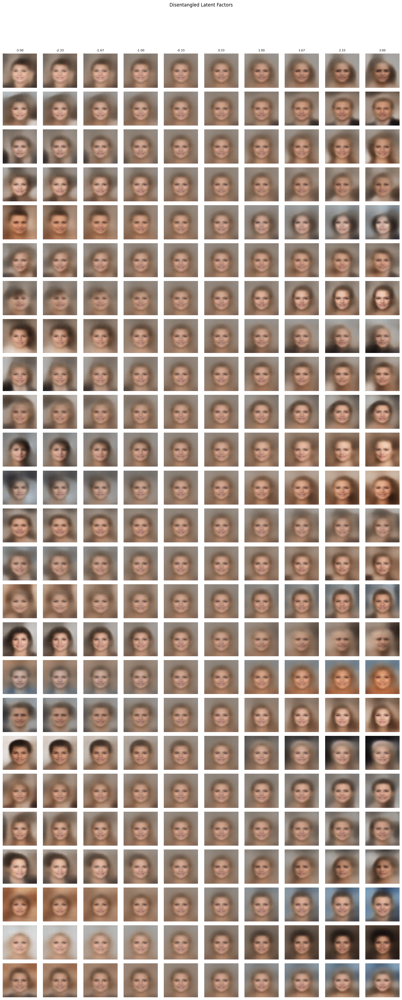

Disentaglement in (-2, 2)


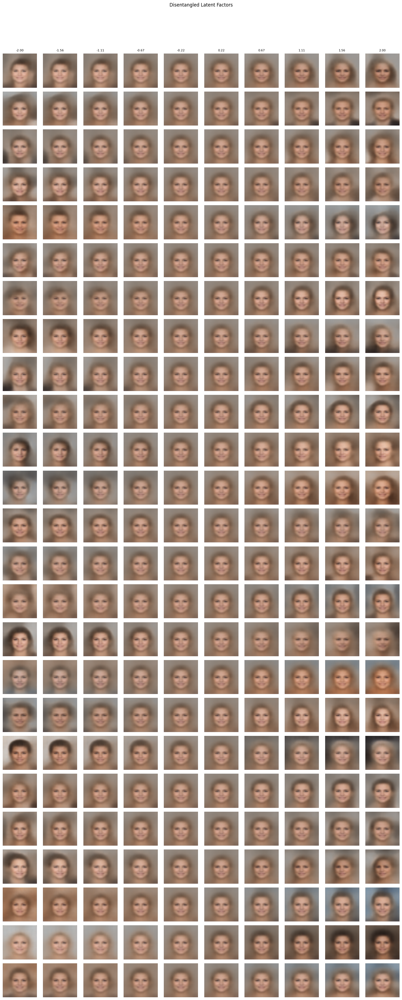

Disentaglement in (-4, 4)


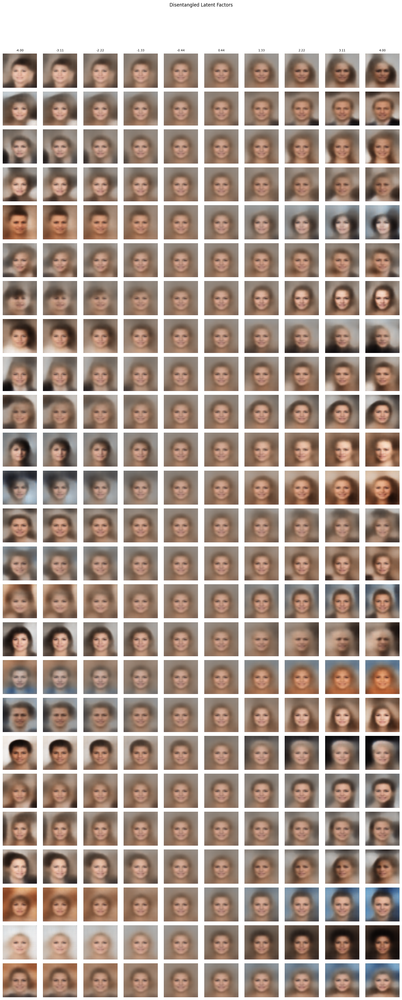

Disentaglement in (-5, 5)


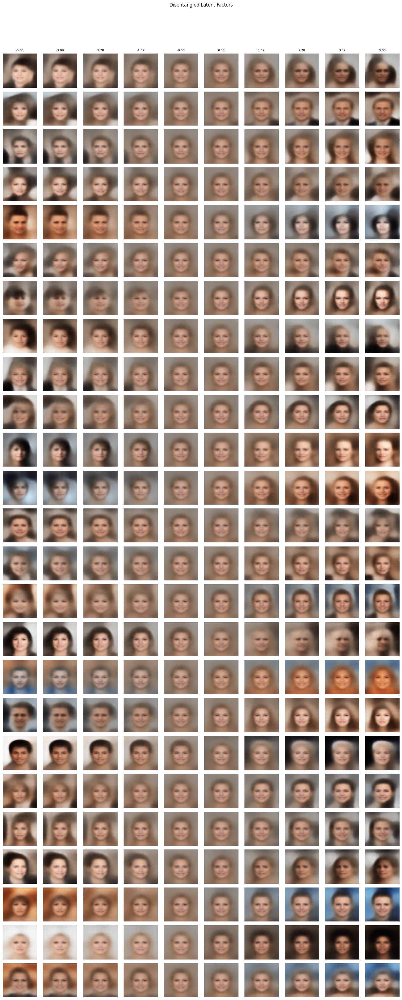

In [10]:
def visualize_disentangled_latent_factors(model, latent_dim, num_samples=10, variation_range=(-3, 3)):
    """
    Visualize disentangled latent factors by varying one latent dimension.

    Parameters:
    - model: Trained β-VAE model.
    - latent_dim: Number of latent dimensions in the model.
    - num_samples: Number of samples to generate per latent dimension.
    - variation_range: Range of values to vary for each latent dimension.
    """
    model.eval()

    #--------------------------------------------------------------------------------------------------------
    # CODE HERE
    device = next(model.parameters()).device
    base_z = torch.zeros(latent_dim).to(device)
    values = torch.linspace(variation_range[0], variation_range[1], steps=num_samples).to(device)
    fig, axes = plt.subplots(latent_dim, num_samples, figsize=(num_samples * 1.5, latent_dim * 1.5))

    for dim in range(latent_dim):
        for i, val in enumerate(values):
            z = base_z.clone()
            z[dim] = val
            with torch.no_grad():
                generated = model.decode(z.unsqueeze(0)).squeeze(0).cpu()
            img = generated.permute(1, 2, 0).numpy()
            img = np.clip(img, 0, 1)

            axes[dim, i].imshow(img)
            axes[dim, i].axis('off')

            if dim == 0:
                axes[dim, i].set_title(f"{val:.2f}", fontsize=8)
        axes[dim, 0].set_ylabel(f"z[{dim}]", fontsize=10, rotation=0, labelpad=20)

    plt.suptitle("Disentangled Latent Factors")
    plt.tight_layout()
    plt.subplots_adjust(top=0.93)
    plt.show()

    #--------------------------------------------------------------------------------------------------------

# Parameters
latent_dim = 25  # As per your model
num_samples = 10  # Number of variations per latent dimension
variation_range = [(-3,3), (-2,2), (-4,4), (-5,5)] # Adjust this range if needed i.e (-3,3)

# Visualize disentangled latent factors
for variant in variation_range:
    print(f"Disentaglement in {variant}")
    visualize_disentangled_latent_factors(model=model, latent_dim=latent_dim, num_samples=num_samples, variation_range=variant)


<div style="text-align: center;">
    <h1 style="color: rgb(173, 216, 230); font-size: 50px; font-weight: bold;">
        ❄️ <span style="color: white;">Chapter 3</span> - 
        <span style="color: rgb(173, 216, 230);">Winter</span> ❄️
        <span style="color: white;">[30 Points]</span>
    </h1>
    <hr style="height: 8px; width: 80%; background: linear-gradient(to right, white, rgb(173, 216, 230), white); border: none; margin-top: 10px; margin-bottom: 10px;">
</div>


<!-- SPORE WARNING HEADER -->
<div style="width: 100%; text-align: center;">
    <h1 style="color: rgb(248, 247, 249); font-size: 50px; font-weight: bold;">
        ☣️ <b>WATCH OUT!</b>  
        <span style="color: rgb(130, 89, 214);">
            🦠 SPORES AHEAD!  
        </span>  
        <span style="color: rgb(255, 255, 255);">
            If You Breathe…....... <b>You’re Done!</b> 💀  
        </span>
    </h1>
    <hr style="height: 8px; width: 100%; background: linear-gradient(to right, white, rgb(130, 89, 214), white); border: none; margin-top: 10px; margin-bottom: 10px;">
</div>

<!-- SPORE-INFESTED IMAGES -->
<div style="text-align: center;">
    <img src="TLOU8.jpg" style="width: 48%; height: 1100px; filter: brightness(80%) contrast(110%) saturate(120%); margin-right: 10px; border: 5px solid rgb(130, 89, 214);">
    <img src="TLOU7.jpg" style="width: 48%; height: 1100px; filter: brightness(80%) contrast(110%) saturate(120%); border: 5px solid rgb(130, 89, 214);">
</div>

<!-- SPORE LORE WITH DRAMATIC BACKGROUND -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white; 
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; 
            width: 80%; margin: auto; 
            box-shadow: 0px 0px 30px rgba(130, 89, 214, 0.6);">
    
<b>Ellie moves cautiously through the ruins of Hollywood.</b>  
A dead city, swallowed by time. Silent. Abandoned.  

Until she sees it—  

A <b>thick, swirling mist</b> floating in the dim light.  
Particles drift in the air like specks of **death itself**.  

🦠 **SPORES.** Thick. Dense. **Lethal.**  

She tightens her mask.  
Her breath slows. **She has to move forward.**  

Every inch of the air is <b>infected</b>,  
the last whispers of a world long gone.  

</div>

<!-- SUBHEADING: WHAT ARE SPORES? -->
<div style="padding: 10px; text-align: center;">
    <h2 style="color: white; font-size: 30px; font-weight: bold;">
        🦠 <b>What Are Spores?</b>  
    </h2>
</div>

<!-- SPORE LORE WITH DRAMATIC BACKGROUND -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white; 
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; 
            width: 80%; margin: auto; 
            box-shadow: 0px 0px 30px rgba(130, 89, 214, 0.6);">
    
<b>According to <span style="color: rgb(130, 89, 214);">The Last of Us lore</span></b>, Spores are  
<b>airborne fungal particles</b> carrying the Cordyceps infection.  
They <b>linger in enclosed spaces</b>, unseen, yet deadly.  

<br>  

💀 <b>Without protection, exposure to Spores is a death sentence.</b> 💀  

<br>

Ellie, immune yet suffocating in the thick air, moves cautiously.  

<br>

<b>The air tastes wrong. The silence is suffocating.</b>  

<br>

Then—  

<br>

🚨 <b>This is where everything changes.</b> 🚨  

</div>


<!-- SUBHEADING: NO MORE SKELETON CODE -->
<div style="padding: 10px; text-align: center;">
    <h2 style="color: white; font-size: 30px; font-weight: bold;">
        💀 <b>NO MORE SKELETON CODE!</b> 💀
    </h2>
</div>

<!-- CINEMATIC BLOCK -->
<div style="padding: 30px; font-size: 22px; color: white; 
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; 
            width: 80%; margin: auto; 
            box-shadow: 0px 0px 30px rgba(130, 89, 214, 0.6);">
    <b>With limited visibility, no outside help, and nowhere to run…</b>  
    Ellie must rely on her instincts.  
    <b>And so must YOU.</b>  
</div>

<!-- FINAL MESSAGE -->
<div style="padding: 30px; font-size: 22px; color: white; 
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; 
            width: 80%; margin: auto; 
            box-shadow: 0px 0px 30px rgba(130, 89, 214, 0.6);">
    She <b>must</b> find the WLF. She <b>must</b> finish what she started.  
    <b>You have unfinished business too.</b>  
</div>


<div style="width: 100%; text-align: center;">
<h1 style="color:rgb(244, 244, 245); font-size: 40px; font-weight: bold;">
    <span style="text-decoration-color: white;">Let's Continue the: 
    <span style="color:rgb(130, 89, 214);">Hunt</span></span> 🐾
</h1>
<hr style="height: 10px; width: 100%; background-color: white; border: none; margin-top: 10px; margin-bottom: 10px;">
</div>

## 🛠️ **Your Task: Analyzing Disentangled Representations Across β Values**  

Ellie has learned to distinguish the **Infected from the WLF** using deep learning, but now she must **fine-tune her approach**. Different **β-values** result in different **levels of disentanglement**—your job is to analyze and visualize them.

---

## **🎯 What You Need to Do:**
1️⃣ **Train a β-VAE model** for at least **4 different β values** (1, 5, 10, 50). --> No need to do this again if you already did it above then just use those models.
2️⃣ **Run the training process** for **at least 3 epochs** (you can train for longer).  --> Same procedure as above , i am just repeating the steps incase you do not want to scroll above.
3️⃣ **Save each trained model** separately. --> Ideally you should have done this before but not my fault if you did not , please train again then. No Way around this. 
4️⃣ **Visualize the effect of β** on the learned latent space:  
   - Pick a **suitable variation range** (e.g., -3 to 3).  
   - Generate and plot **disentangled latent factors** for **each β value**.  
5️⃣ **Compare the results**—observe **how β affects disentanglement** and reconstruction quality.

---

## **📊 Visualizing the Disentangled Latent Factors**  

For each trained model, you must **vary each latent dimension** and generate corresponding images. The goal is to see **how different features change** when we tweak the latent variables.

🚀 **Your final visualization should include:**
- **Separate plots for each β value**.
- **Variations across latent dimensions**.
- **A comparison of how different β values affect feature disentanglement**.

---

💀 **Ellie's revenge isn't over yet**—and neither is your task!  
🔥 **Push forward, complete the visualizations, and see the true power of β-VAE!**  

---

In [11]:
# Training 
# 🚀 1. Define Hyperparameters
latent_dim = 10
batch_size = 128
num_epochs = 5
learning_rate = 1e-3
beta_values = [1, 5, 10, 50]
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 🚀 3. Define Training Function
def train_epoch(model, dataloader, optimizer, beta):
    model.train()
    total_recon = 0.0
    total_kld = 0.0
    total_loss = 0.0

    for x, _ in tqdm(dataloader, desc="Training", leave=False):
        x = x.to(device)
        optimizer.zero_grad()
        recon_x, mu, logvar = model(x)
        recon_loss, kld_loss, loss = beta_vae_loss(recon_x, x, mu, logvar, beta)
        loss.backward()
        optimizer.step()

        total_recon += recon_loss.item()
        total_kld += kld_loss.item()
        total_loss += loss.item()

    N = len(dataloader.dataset)
    return total_recon / N, total_kld / N, total_loss / N

# 🚀 4. Define Validation Function
def validate_epoch(model, dataloader, beta):
    model.eval()
    total_recon = 0.0
    total_kld = 0.0
    total_loss = 0.0

    with torch.no_grad():
        for x, _ in tqdm(dataloader, desc="Validating", leave=False):
            x = x.to(device)
            recon_x, mu, logvar = model(x)
            recon_loss, kld_loss, loss = beta_vae_loss(recon_x, x, mu, logvar, beta)

            total_recon += recon_loss.item()
            total_kld += kld_loss.item()
            total_loss += loss.item()

    N = len(dataloader.dataset)
    return total_recon / N, total_kld / N, total_loss / N

# 🚀 2. Initialize Model & Optimizer
# 🚀 5. Train Model for Each β Value
results = defaultdict(list)

for beta in beta_values:
    print(f"\n training with beta = {beta}")
    model = BetaVAE(latent_dim=latent_dim, beta=beta).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

    for epoch in range(num_epochs):
        print(f"epoch {epoch+1}/{num_epochs}")
        tr_recon, tr_kld, tr_total = train_epoch(model, train_loader, optimizer, beta)
        val_recon, val_kld, val_total = validate_epoch(model, val_loader, beta)

        print(f"Train Recon: {tr_recon:.2f} KLD: {tr_kld:.2f} Total: {tr_total:.2f}")
        print(f"Val Recon: {val_recon:.2f} KLD: {val_kld:.2f} Total: {val_total:.2f}")

        results[beta].append({
            "train_recon": tr_recon,
            "train_kld": tr_kld,
            "train_total": tr_total,
            "val_recon": val_recon,
            "val_kld": val_kld,
            "val_total": val_total,
        })

    # Save model
    save_path = f"/kaggle/working/beta_vae_beta{beta}.pt"
    torch.save(model.state_dict(), save_path)
    print(f"Model saved to: {save_path}")




 training with beta = 1
epoch 1/5


Train Recon: 1740.13 KLD: 50.60 Total: 1790.73
Val Recon: 1283.71 KLD: 41.06 Total: 1324.77
epoch 2/5


Train Recon: 1277.54 KLD: 44.14 Total: 1321.68
Val Recon: 1276.64 KLD: 42.66 Total: 1319.30
epoch 3/5


Train Recon: 1223.68 KLD: 38.56 Total: 1262.24
Val Recon: 1326.26 KLD: 37.41 Total: 1363.67
epoch 4/5


Train Recon: 1205.74 KLD: 37.17 Total: 1242.91
Val Recon: 1217.64 KLD: 36.57 Total: 1254.21
epoch 5/5


Train Recon: 1187.20 KLD: 35.43 Total: 1222.64
Val Recon: 1171.99 KLD: 34.49 Total: 1206.49
Model saved to: /kaggle/working/beta_vae_beta1.pt

 training with beta = 5
epoch 1/5


Train Recon: 1774.48 KLD: 28.41 Total: 1916.52
Val Recon: 1308.69 KLD: 24.62 Total: 1431.77
epoch 2/5


Train Recon: 1316.70 KLD: 23.79 Total: 1435.66
Val Recon: 1280.71 KLD: 25.65 Total: 1408.96
epoch 3/5


Train Recon: 1274.58 KLD: 23.04 Total: 1389.77
Val Recon: 1255.07 KLD: 22.42 Total: 1367.17
epoch 4/5


Train Recon: 1242.22 KLD: 22.70 Total: 1355.70
Val Recon: 1229.59 KLD: 21.59 Total: 1337.54
epoch 5/5


Train Recon: 1216.85 KLD: 22.47 Total: 1329.22
Val Recon: 1201.44 KLD: 22.78 Total: 1315.33
Model saved to: /kaggle/working/beta_vae_beta5.pt

 training with beta = 10
epoch 1/5


Train Recon: 1853.87 KLD: 21.17 Total: 2065.55
Val Recon: 1426.26 KLD: 21.06 Total: 1636.87
epoch 2/5


Train Recon: 1350.15 KLD: 19.10 Total: 1541.11
Val Recon: 1295.85 KLD: 18.71 Total: 1482.98
epoch 3/5


Train Recon: 1304.67 KLD: 18.74 Total: 1492.11
Val Recon: 1317.10 KLD: 18.74 Total: 1504.54
epoch 4/5


Train Recon: 1262.70 KLD: 18.60 Total: 1448.68
Val Recon: 1235.84 KLD: 18.84 Total: 1424.27
epoch 5/5


Train Recon: 1259.85 KLD: 18.72 Total: 1447.02
Val Recon: 1308.68 KLD: 17.63 Total: 1485.02
Model saved to: /kaggle/working/beta_vae_beta10.pt

 training with beta = 50
epoch 1/5


Train Recon: 2168.64 KLD: 10.03 Total: 2670.18
Val Recon: 1635.11 KLD: 10.30 Total: 2149.93
epoch 2/5


Train Recon: 1587.57 KLD: 9.22 Total: 2048.55
Val Recon: 1687.00 KLD: 9.02 Total: 2137.93
epoch 3/5


Train Recon: 1556.35 KLD: 9.25 Total: 2018.65
Val Recon: 1512.60 KLD: 9.45 Total: 1984.97
epoch 4/5


Train Recon: 1521.46 KLD: 9.30 Total: 1986.22
Val Recon: 1541.04 KLD: 9.69 Total: 2025.64
epoch 5/5


Train Recon: 1495.20 KLD: 9.36 Total: 1963.12
Val Recon: 1462.44 KLD: 9.62 Total: 1943.42
Model saved to: /kaggle/working/beta_vae_beta50.pt


In [12]:
# Create a table of final validation losses
table_data = []
for beta in beta_values:
    final_epoch = results[beta][-1]
    row = {
        "Beta": beta,
        "Total Loss": round(final_epoch["val_total"], 2),
        "KL Divergence": round(final_epoch["val_kld"], 4),
        "Reconstruction Loss": round(final_epoch["val_recon"], 2)
    }
    table_data.append(row)

results_df = pd.DataFrame(table_data)
print(results_df)


   Beta  Total Loss  KL Divergence  Reconstruction Loss
0     1     1206.49        34.4944              1171.99
1     5     1315.33        22.7780              1201.44
2    10     1485.02        17.6345              1308.68
3    50     1943.42         9.6197              1462.44


In [13]:
# Code
beta_values = [1, 5, 10, 50]
latent_dim = 10
model_paths = {
    1: "/kaggle/working/beta_vae_beta1.pt",
    5: "/kaggle/working/beta_vae_beta5.pt",
    10: "/kaggle/working/beta_vae_beta10.pt",
    50: "/kaggle/working/beta_vae_beta50.pt"
}



def visualize_for_beta(beta, variation_range=(-3, 3), num_samples=10):
    print(f"\n disentanglement for beta = {beta}")
    
    model = BetaVAE(latent_dim=latent_dim, beta=beta).to(device)
    model.load_state_dict(torch.load(model_paths[beta], map_location=device))
    
    visualize_disentangled_latent_factors(
        model=model,
        latent_dim=latent_dim,
        num_samples=num_samples,
        variation_range=variation_range
    )


<ipython-input-13-744708925eda>:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_paths[beta], map_location=device))



 disentanglement for beta = 1


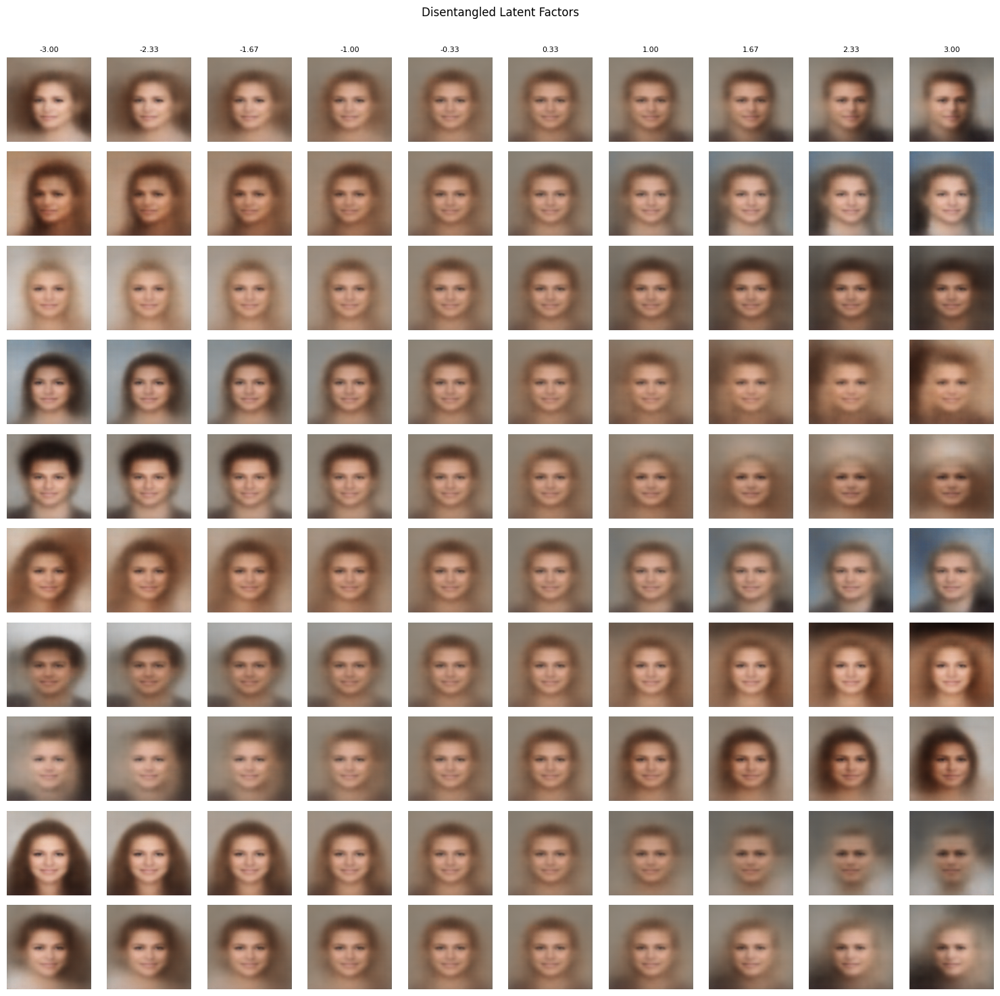


 disentanglement for beta = 5


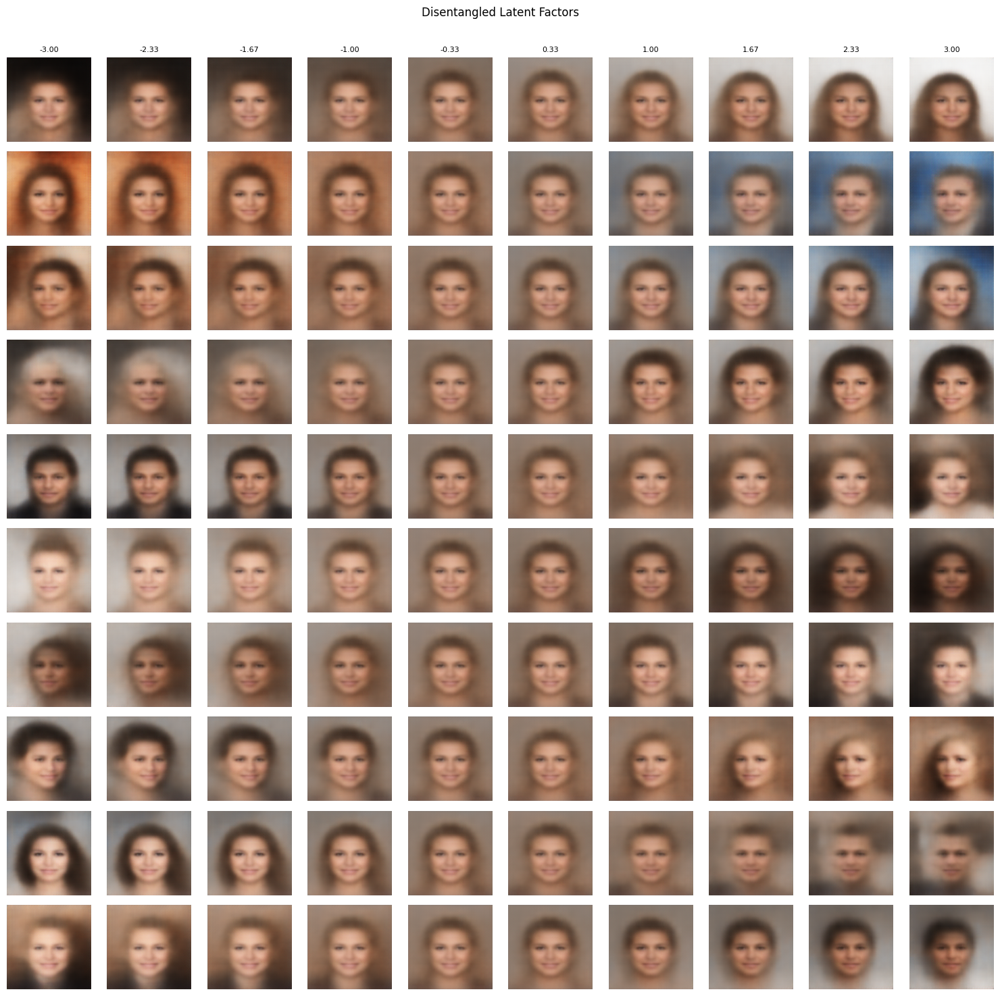


 disentanglement for beta = 10


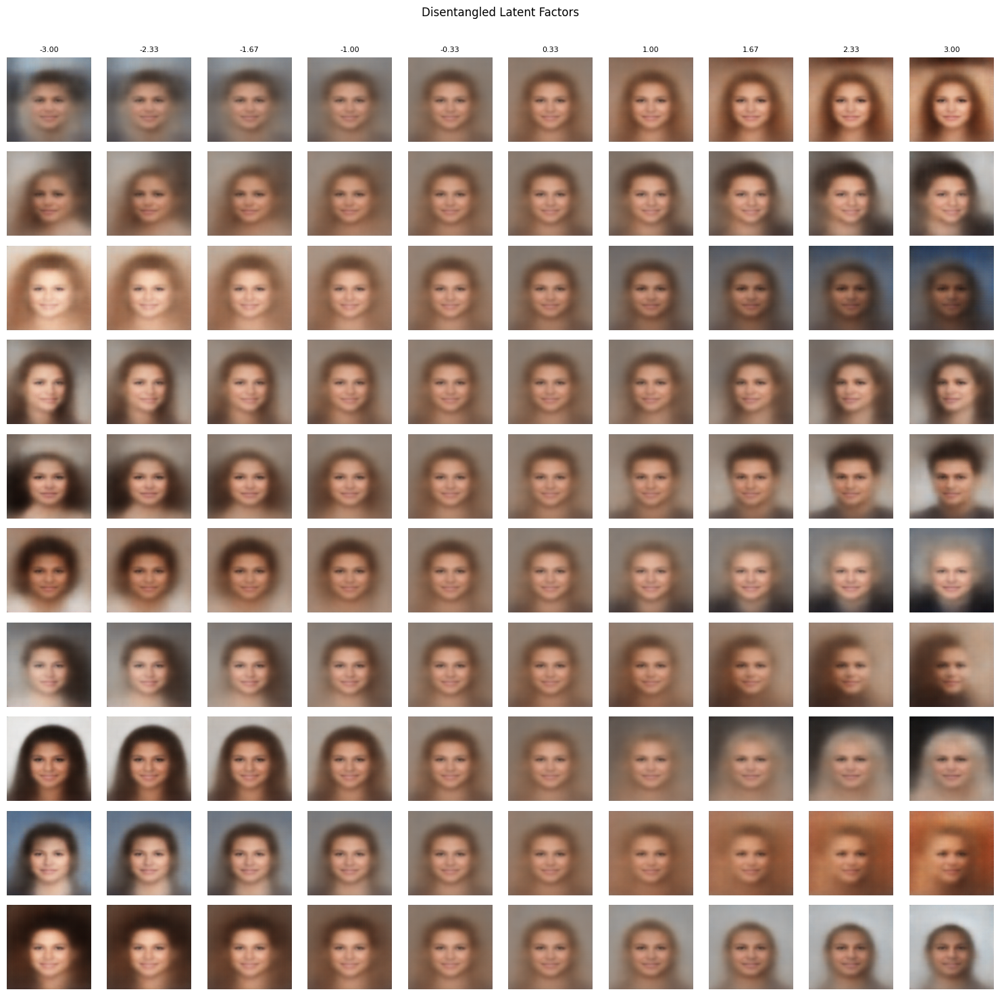


 disentanglement for beta = 50


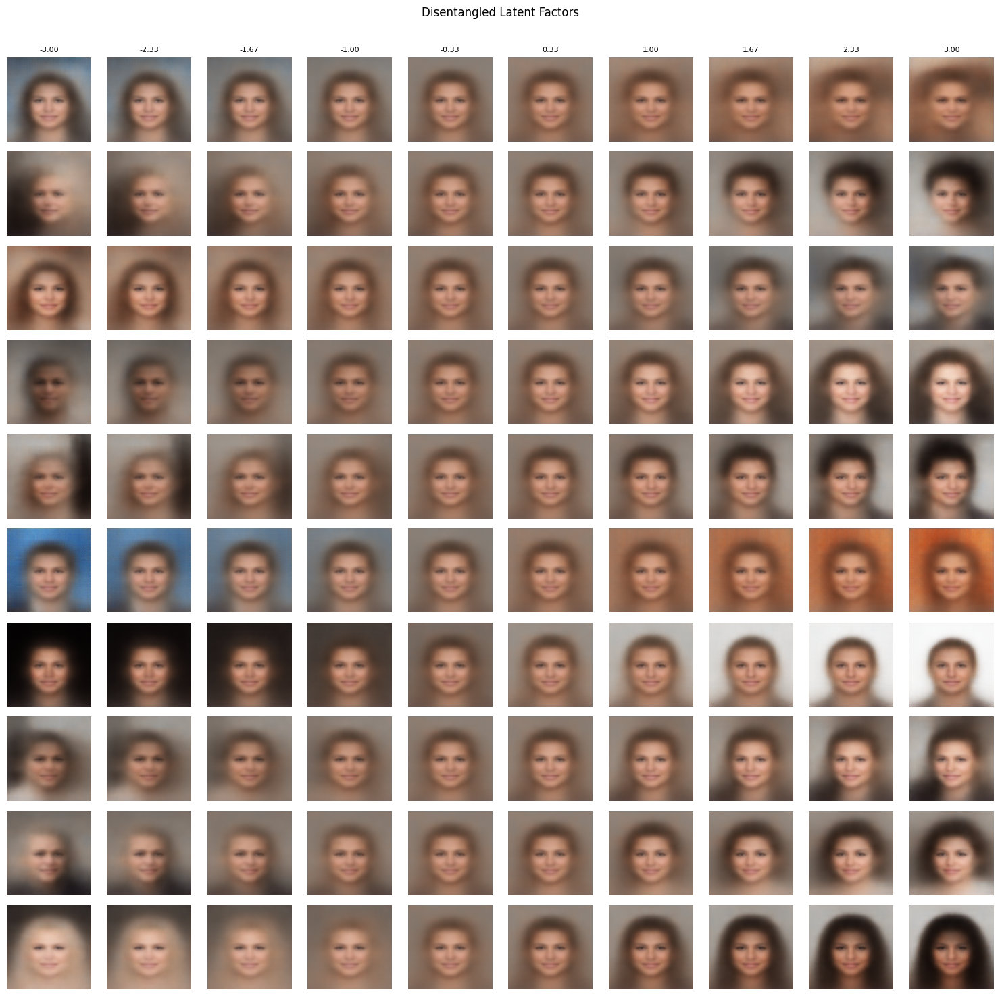

In [14]:
for beta in beta_values:
    visualize_for_beta(beta, variation_range=(-3, 3), num_samples=10)


<!-- EXPLANATION REQUEST HEADER -->
<div style="width: 100%; text-align: center;">
    <h2 style="color: white; font-size: 30px; font-weight: bold;">
        📝 <b>Please Explain Your Results in Full Detail in the Markdown Below</b> 📝
    </h2>
</div>

<!-- INSTRUCTION BLOCK -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white; 
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; 
            width: 80%; margin: auto; 
            box-shadow: 0px 0px 30px rgba(130, 89, 214, 0.6);">
    
<b>Provide a thorough breakdown of your results.</b>  
Explain every aspect, including:  

- ✅ **Architecture Choice** – Why did you choose this specific architecture? 
- ✅ **Observations** – What do the numbers and trends indicate?  
- ✅ **Patterns** – Are there any significant trends in your results?  
- ✅ **Comparison** – How do your findings compare to expected outcomes?  
- ✅ **Errors/Anomalies** – Any unexpected results? Why might they have occurred?  
- ✅ **Insights** – What conclusions can you draw from these results?  

Take your time to articulate **every detail clearly and concisely**.  

</div>


<!-- CHAPTER 3 HEADER -->
<div style="text-align: center;">
    <h1 style="color: rgb(255, 165, 0); font-size: 50px; font-weight: bold;">
        🍂 <span style="color: white;">Chapter 4</span> -  
        <span style="color: rgb(255, 165, 0);">Autumn</span> 🍂
        <span style="color: white;">[10 Points]</span>
    </h1>
    <hr style="height: 8px; width: 80%; background: linear-gradient(to right, white, rgb(255, 165, 0), white); border: none; margin-top: 10px; margin-bottom: 10px;">
</div>

<!-- REFLECTION QUESTIONS BLOCK -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white; 
            background: rgba(0, 0, 0, 0.6); border-radius: 15px; 
            width: 80%; margin: auto; 
            box-shadow: 0px 0px 30px rgba(255, 165, 0, 0.6);">
    
<b>Now that you have reached Autumn, it's time to reflect.</b>  
Answer the following questions thoughtfully:  

## 🔍 Reflection Question 1
### How does increasing β affect disentanglement and reconstruction quality? Please provide a detailed response (Max 100 Words)

Ans: As we increase beta value the recontruction loss increases while the divergence decreases, the lower divergence indicates that the regularization is stronger and makes the latent space closer to standard guassian which leads to better latent disentanglement. But this comes at the cost of lower reconstruction quality which is hard to see from the results but visible when comparing the losses and comparing the pictures of beta value 1 and beta value 50, hence higher beta give better features disentanglement but worser reconstruction







## 🔍 Reflection Question 2
### Identify and discuss the limitations of β-VAE, such as loss of fine-grained details in reconstructions or failure to disentangle specific factors. Please provide a detailed response (Max 100 Words)

Ans: Eventhough beta VAE improves disentanglement, it increases the loss on recontruction quality, leading to poor quality recontruction hence it produces blurrier images and loses fine grained details, as it is trying harder to align the latent distribution to standard guassian rather than focusing on better recontruction. Beta VAE fails to disentangle when factors are highly correlated or not well represented in the dataset 


<!-- FINAL MISSION HEADER -->
<div style="text-align: center;">
    <h1 style="color: rgb(255, 215, 0); font-size: 55px; font-weight: bold;">
        🎯 <span style="color: white;">Mission Accomplished!</span>  
    </h1>
    <h2 style="color: rgb(255, 140, 0); font-size: 40px; font-weight: bold;">
        <b>The Last of Us: DL Edition Ends Here</b> 🎮🔥
    </h2>
    <hr style="height: 10px; width: 80%; background: linear-gradient(to right, white, rgb(255, 140, 0), white); border: none; margin-top: 10px; margin-bottom: 10px;">
</div>

<!-- STORY CLOSURE --> 
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white; background: rgba(0, 0, 0, 0.7); border-radius: 15px; width: 80%; margin: auto; box-shadow: 0px 0px 40px rgba(255, 140, 0, 0.7);">
<b>A Tale of Vengeance, Survival, and AI</b>

The journey was <b>brutal</b>, the road was <b>long</b>, but <b>Ellie never faltered</b>.
Through <b>blood, sweat, and deep learning</b>, she <b>saw her mission through to the end</b>.

With the power of Variational Autoencoders (VAEs), she uncovered hidden enemies, infiltrating their ranks and exposing those who lurked in the shadows.
The very faction that had <b>taken everything from her</b>—that shattered the last remnants of her world—had now been <b>brought to justice</b>.

💔 <b>For those she lost. For those still fighting.</b> 💔

</div> <!-- SUBHEADING: HOW DID ELLIE USE DL? --> <div style="padding: 10px; text-align: center;"> <h2 style="color: white; font-size: 30px; font-weight: bold;"> 🔬 <b>How Did Ellie Use Deep Learning to Complete Her Mission?</b> </h2> </div> <!-- CINEMATIC STORY BLOCK --> <div style="padding: 30px; text-align: justify; font-size: 22px; color: white; background: rgba(0, 0, 0, 0.7); border-radius: 15px; width: 80%; margin: auto; box-shadow: 0px 0px 40px rgba(255, 140, 0, 0.7);">
🔥 <b>In a world where survival depends on identifying the enemy</b>, Ellie turned to deep learning for answers.

- ✅ Using a β-VAE, she <b>disentangled hidden facial attributes</b> and <b>revealed those who wished to stay hidden</b>.
- ✅ She experimented with different <b>β values</b>, learning how the model traded off between <b>accuracy and interpretability</b>.
- ✅ With enough training, she <b>decoded the WLF's disguises</b>, proving that <b>no mask, no shadow, no camouflage could stop the power of AI</b>.

Her mission was not just about revenge, but about ensuring no one else suffered the same fate.
With the memory of the fallen in her heart and science in her hands, she rewrote fate itself.

⚔️ <b>Justice has been served.</b>
🎮 The Last of Us: AI Edition has come to a close.

🥀 For those we've lost. For those still standing. 🥀

</div>


<!-- MARKING CRITERIA -->
<div style="padding: 10px; text-align: center;">
    <h2 style="color: white; font-size: 35px; font-weight: bold;">
        📜 <b>Marking Criteria & Submission Guidelines</b>  
    </h2>
</div>

<!-- CRITERIA BLOCK -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white;
            background: rgba(0, 0, 0, 0.7); border-radius: 15px;
            width: 80%; margin: auto;
            box-shadow: 0px 0px 40px rgba(255, 140, 0, 0.7);">

## 📊 **How Will You Be Evaluated?**  

Unlike previous parts of the assignment, there are **no strict benchmarks** (e.g., specific loss values).  
This part is **open-ended**, meaning **multiple correct implementations exist**.  

✅ **We will assess your work based on the following:**  
- **Architecture choices**: How well have you structured your VAE model?  
- **Results**: How effectively does your model learn meaningful latent representations?  
- **Quality of Visualizations**: The true measure of your model's success is in its ability to **clearly separate different features**. Your plots should **demonstrate disentanglement effectively**.  

</div>

<!-- SUBMISSION REQUIREMENTS -->
<div style="padding: 10px; text-align: center;">
    <h2 style="color: white; font-size: 30px; font-weight: bold;">
        📂 <b>Submission Requirements</b>  
    </h2>
</div>

<!-- SUBMISSION INSTRUCTIONS BLOCK -->
<div style="padding: 30px; text-align: justify; font-size: 22px; color: white;
            background: rgba(0, 0, 0, 0.7); border-radius: 15px;
            width: 80%; margin: auto;
            box-shadow: 0px 0px 40px rgba(255, 140, 0, 0.7);">

### 1️⃣ **Model Checkpoints**  
📌 **Save all 4 trained models** (one for each β value) and upload them to **Dropbox** under your name.  
- **File format**: `.zip`  
- **Naming format**: `<RollNumber>_PA3_2_Models.zip`  

### 2️⃣ **Notebook Submission**  
📌 Submit **this notebook and its Python file** (`.ipynb` and `.py`) on **LMS** with the rest of the assignment.  

</div>

<!-- FINAL CONGRATULATIONS BLOCK -->
<div style="padding: 30px; font-size: 22px; color: white;
            background: rgba(0, 0, 0, 0.7); border-radius: 15px;
            width: 80%; margin: auto;
            box-shadow: 0px 0px 40px rgba(255, 140, 0, 0.7); text-align: center; font-weight: bold;">
    
🔥 **If you’ve made it this far, congratulations!**  
You’ve successfully implemented a **β-VAE**, explored its impact, and helped Ellie on her quest.  

👑 <b>You are now a true deep learning survivor.</b>  

🚀 **See you in the next adventure!**  

</div>


~ A Saad Haroon Production